# Automatic Music Generator


---
---

<ul>
<li>In this project, we create a music generator using the <b>LSTM</b> (Long Short-Term Memory) model, a machine learning algorithm to create pieces of music from existing music data. The model utilizes deep learning techniques (LSTM neural network) to analyse the patterns and structure of music pieces and create new ones of similar style.</li><br>

<li><b>Recurrent Neural Network</b> (RNN) is a type of artificial neural network which uses sequential data or time series data. These deep learning algorithms are commonly used for ordinal or temporal problems. They are known to be incorporated in applications such as Siri, voice searching, Google Translate,  natural language processing (nlp), etc.</li><br>

<li>LSTM is a type of RNN which can produce to remember outputs of each node and produce the next output efficiently. The reason for selecting LSTM is its ability to combat the RNN model’s vanishing gradient or long-term dependence issue. Gradient vanishing refers to loss of information in a neural network. LSTM tackles this issue by simply ignoring information which is useless for further processing.</li><br>

<li>The system works by training the LSTM model on a large dataset of music pieces. Once the model is trained, it generates new pieces of music by predicting the next note or sequence of notes based on the previous input notes. The output is processed to produce a finished piece of music in MIDI format. </li>


In [1]:
#Importing Libraries
from music21 import *
import glob
import os
from tqdm import tqdm
import numpy as np
import random
from IPython.display import Image, Audio
import matplotlib.pyplot as plt 
from tensorflow import keras
from keras.layers import LSTM, Dense, Input, Dropout
from keras.models import Sequential, Model, load_model
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")

In [12]:
#Loading and Parsing Data

def read_files(file):
    notes = []
    parsing = None
    #Parsing mid files
    midi = converter.parse(file)
    #Seperation of intruments
    instrmt = instrument.partitionByInstrument(midi)

    for part in instrmt.parts:
        #Execute following code only if the intrument is a Piano
        if 'Piano' in str(part):
            parsing = part.recurse()

            #Check if the elements contain Notes or Chords
            for element in parsing:
                if type(element) == note.Note:
                    notes.append(str(element.pitch))
                elif type(element) == chord.Chord:
                    notes.append('.'.join(str(n) for n in element.normalOrder))

    # return the list of notes
    return notes

In [15]:
#Data Exploration
    #Exploring the data Corpus
    #Simplifying the Corpus to build the model

#Retrieve path containing folder of mid files
file_path = glob.glob('mozart/*.mid')
# for path in file_path:
#     print(path)
notes_array = np.array([read_files(i) for i in tqdm(file_path, position=0, leave=True)])
print(notes_array)
#Find unique notes
sum_notes = sum(notes_array, [])
unique_notes = list(set(sum_notes))
print("Unique Notes:", len(unique_notes))

#Frequency of notes
freq = dict(map(lambda x: (x, sum_notes.count(x)), unique_notes))

#Threshold frequency
print("\nFrequency notes")
for i in range(30, 100, 20):
    print(i, ":", len(list(filter(lambda x: x[1] >= i, freq.items()))))

#Filter notes having threshold greater than 50
freq_notes = dict(filter(lambda x: x[1] >= 50, freq.items()))

#Create new notes from freq notes
new_notes = [[i for i in j if i in freq_notes] for j in notes_array]

#Dictionary having key as note index and value as notes
index_to_note = dict(enumerate(freq_notes))

#Dictionary having key as notes and value as note index (Reverse of previous dictionary)
note_to_index = dict(map(reversed, index_to_note.items()))

100%|██████████| 21/21 [00:25<00:00,  1.20s/it]


[list(['2.6.9', '9.2', 'G5', '2.6', 'F#5', 'E5', 'F#5', 'A5', '4.7', 'G5', 'F#5', 'G5', 'A5', '6.9', 'A5', 'B5', 'C#6', 'D6', 'A5', 'F#3', 'D4', 'F#5', 'D3', 'D4', 'A5', 'E3', 'G5', 'F#5', 'D4', 'G5', 'A5', 'A3', 'G5', 'C#4', 'F5', '2', 'F#5', 'G5', '2.6', 'F#5', 'E5', 'F#5', 'A5', '4.7', 'G5', 'F#5', 'G5', 'A5', '6.9', 'A5', 'B5', 'C#6', 'D6', 'A5', 'F#3', 'D4', 'F#5', 'D3', 'D4', 'A5', 'E3', 'G5', 'F#5', 'D4', 'G5', 'A5', 'A3', 'G5', 'F#5', 'C#4', 'E5', 'D5', 'D4', 'F#4', 'A4', 'D4', 'F#4', '6.7', 'D4', '6.7', 'F#4', '6.7', '6.7', 'D4', 'F#5', 'E5', 'F#4', 'D5', 'C#5', 'E4', 'G4', 'A4', 'E4', 'G4', 'E5', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'C#4', 'B3', 'E5', 'A3', 'C#4', 'A4', 'A3', 'C#4', '7.9', 'A3', '7.9', 'C#4', '7.9', '7.9', 'G3', 'G5', 'F#5', 'C#4', 'E5', 'D5', 'F#3', 'D4', 'A4', 'F#3', 'D4', 'F#5', 'F#3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C#4', 'F#5', 'D4', 'D5', 'E5', 'F#5', 'G5', 'A5', 'B5', 'C#6', 'D6', 'C#6', 'B5', '6.9', 'A5', 'G5', '6.9', 'F#5', 'E5', '6.9', 'D5', 

Average occurence of a note in Corpus:  243.6768558951965
Most frequent note in Corpus:  2355 times
Least frequent note in Corpus:  1 times


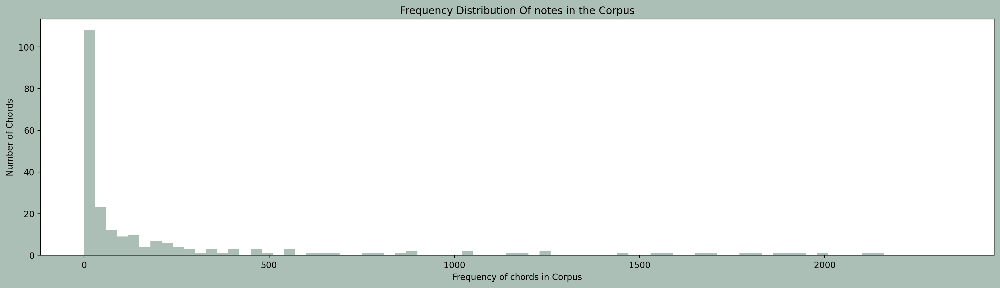

In [16]:
Notes = list(freq.keys())
Occurence = list(freq.values())
#Average occurence for a note in Corpus (Corpus may refer to any collection of musical data)
def Average(lst):
    return sum(lst) / len(lst)
print("Average occurence of a note in Corpus: ", Average(Occurence))
print("Most frequent note in Corpus: ", max(Occurence), "times")
print("Least frequent note in Corpus: ", min(Occurence), "times")

# Plotting the distribution of Notes
plt.figure(figsize=(20,5),facecolor="#ABBFB6")
bins = np.arange(0,(max(Occurence)), 30) 
plt.hist(Occurence, bins=bins, color="#ABBFB6")
plt.title("Frequency Distribution Of notes in the Corpus")
plt.xlabel("Frequency of chords in Corpus")
plt.ylabel("Number of Chords")
plt.show()

In [17]:
#Building the model
    #Initialising the Model
    #Defining and Training the model by adding layers
    #Compiling the Model

timesteps = 50

#Store values of input and output
x = []
y = []

for i in new_notes:
    for j in range(0, len(i)-timesteps):
        #Input contains current index + timestep
        #Output contains next index after timestep
        inp = i[j:j+timesteps]
        out = i[j+timesteps]

        #Append index value of respective notes
        x.append(list(map(lambda x: note_to_index[x], inp)))
        y.append(note_to_index[out])

x_new = np.array(x)
y_new = np.array(y)

#Reshaping the input and out for the model
x_new = np.reshape(x_new, (len(x_new), timesteps, 1))
y_new = np.reshape(y_new, (-1, 1))

#Spliting the input for training and testing sets
#80% for training and 20% for testing sets
x_train, x_test, y_train, y_test = train_test_split(
    x_new, y_new, test_size=0.2, random_state=42)

#Creation of Model
model = Sequential()
#LSTM stacked layer with the latent dimension of 256
model.add(LSTM(256, return_sequences=True,
          input_shape=(x_new.shape[1], x_new.shape[2])))
model.add(Dropout(0.2))
model.add(LSTM(256))
model.add(Dropout(0.2))
model.add(Dense(256, activation='relu'))

#Layer for the output with softmax activation
model.add(Dense(len(note_to_index), activation='softmax'))
model.summary()

#Compile the model using Adam optimizer
model.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam', metrics=['accuracy'])

#Training and validation based on training sets and validation sets
model.fit(
    x_train, y_train,
    batch_size=256, epochs=10,
    validation_data=(x_test, y_test))

#Saving the model for predictions
model.save("s2s") #sequence to sequence

#Loading the model
model = load_model("s2s")
#Generating a random index
index = np.random.randint(0, len(x_test)-1)
#Data of generated index from x_test
music_pattern = x_test[index]


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 50, 256)           264192    
                                                                 
 dropout (Dropout)           (None, 50, 256)           0         
                                                                 
 lstm_1 (LSTM)               (None, 256)               525312    
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense (Dense)               (None, 256)               65792     
                                                                 
 dense_1 (Dense)             (None, 108)               27756     
                                                                 
Total params: 883,052
Trainable params: 883,052
Non-trai

INFO:tensorflow:Assets written to: s2s\assets


INFO:tensorflow:Assets written to: s2s\assets


In [18]:
#Evaluating the model
    #Performance of the model
    #Final output in the form of a melody

out_pred = []  #Store predicted notes

#Iterate until 200 notes are generated
for i in range(200):

    #Reshape the music pattern
    music_pattern = music_pattern.reshape(1, len(music_pattern), 1)

    #Get the maximum probability value from the predicted output
    pred_index = np.argmax(model.predict(music_pattern))
    #Notes from predicted index are appended to output prediction list
    out_pred.append(index_to_note[pred_index])
    music_pattern = np.append(music_pattern, pred_index)

    #Updating music patter at each timestep
    music_pattern = music_pattern[1:]

output_notes = []
for offset, pattern in enumerate(out_pred):
    #if we get a chord instances
    if ('.' in pattern) or pattern.isdigit():
        #Spliting the notes from the chord
        notes_in_chord = pattern.split('.')
        notes = []
        for current_note in notes_in_chord:
            i_curr_note = int(current_note)
            #Casting current note to Note object and append the current note
            new_note = note.Note(i_curr_note)
            new_note.storedInstrument = instrument.Piano()
            notes.append(new_note)

        #Cast current note to Chord object 
        #Offset is one step ahead of previous note to prevent stacking of notes
        new_chord = chord.Chord(notes)
        new_chord.offset = offset
        output_notes.append(new_chord)

    else:
        #Casting pattern to Note object and append the note after applying offset
        new_note = note.Note(pattern)
        new_note.offset = offset
        new_note.storedInstrument = instrument.Piano()
        output_notes.append(new_note)

#Save the mid file
midi_stream = stream.Stream(output_notes)
midi_stream.write('midi', fp='pred_music.mid')

1/1 [==============================] - 0s 28ms/step


'pred_music.mid'

In [19]:
#Display final output
import IPython
from IPython.display import display
IPython.display.Audio("D:\\College\\NIRMA\\Semester 4\\Programming for Scientific Computing\\Projects\pred_music.wav")